In [3]:
# importing the libraries
import numpy as np
import peakutils
#import syntheticdata


from peakutils.plot import plot as pplot
from matplotlib import pyplot as plt
%matplotlib inline
from scipy.optimize import curve_fit
from scipy import interpolate

import pandas as pd

In [4]:
def find_nearest(array,value):
    idx = (np.abs(array-value)).argmin()
    return idx

In [5]:
def loaddata(tadata_filename):
    tadata = np.genfromtxt(tadata_filename, delimiter=',', skip_footer = 16)
    tadata_z = tadata[1:,1:]
    tadata_timedelay = tadata[0,1:]  #timedelay in ps
    tadata_timedelay = np.nan_to_num(tadata_timedelay)
    tadata_nm = tadata[1:,0]  #wavelength in nm
    tadata_nm = np.nan_to_num(tadata_nm)
    tadata_z_corr = np.empty((len(tadata_nm), len(tadata_timedelay)))
    tadata_z_corr = np.nan_to_num(tadata_z)
    
    return tadata, tadata_timedelay, tadata_nm, tadata_z_corr


In [6]:
tadata_filename = 'exp03_20180103 -t0 -chirp.csv'
tadata, tadata_timedelay_raw, tadata_nm_raw, tadata_z_corr_raw=loaddata(tadata_filename)

In [36]:
nm_start = 900
nm_end = 1400
nm_start_idx = find_nearest(tadata_nm_raw, nm_start)
nm_end_idx = find_nearest(tadata_nm_raw, nm_end)

time_start_idx = find_nearest(tadata_timedelay_raw, 1)

tadata_timedelay = tadata_timedelay_raw[time_start_idx:]
#tadata_timedelay = tadata_timedelay_raw

tadata_nm = tadata_nm_raw[nm_start_idx:nm_end_idx]

tadata_z_corr = tadata_z_corr_raw[nm_start_idx:nm_end_idx,time_start_idx:]

In [37]:
print (np.shape(tadata_nm))
print (np.shape(tadata_timedelay))
print (np.shape(tadata_z_corr))

(144,)
(666,)
(144, 666)


In [62]:
def indexes(y, thres=0.3, min_dist=1):
    """Peak detection routine.

    Finds the numeric index of the peaks in *y* by taking its first order difference. By using
    *thres* and *min_dist* parameters, it is possible to reduce the number of
    detected peaks. *y* must be signed.

    Parameters
    ----------
    y : ndarray (signed)
        1D amplitude data to search for peaks.
    thres : float between [0., 1.]
        Normalized threshold. Only the peaks with amplitude higher than the
        threshold will be detected.
    min_dist : int
        Minimum distance between each detected peak. The peak with the highest
        amplitude is preferred to satisfy this constraint.

    Returns
    -------
    ndarray
        Array containing the numeric indexes of the peaks that were detected
    """
    y_raw = y
    y = [abs(k) for k in y_raw]
    
    if isinstance(y, np.ndarray) and np.issubdtype(y.dtype, np.unsignedinteger):
        raise ValueError("y must be signed")

    thres = thres * (np.max(y) - np.min(y)) + np.min(y)
    min_dist = int(min_dist)

    # compute first order difference
    dy = np.diff(y)

    # propagate left and right values successively to fill all plateau pixels (0-value)
    zeros,=np.where(dy == 0)
    
    # check if the singal is totally flat
    if len(zeros) == len(y) - 1:
        return np.array([])
    
    while len(zeros):
        # add pixels 2 by 2 to propagate left and right value onto the zero-value pixel
        zerosr = np.hstack([dy[1:], 0.])
        zerosl = np.hstack([0., dy[:-1]])

        # replace 0 with right value if non zero
        dy[zeros]=zerosr[zeros]
        zeros,=np.where(dy == 0)

        # replace 0 with left value if non zero
        dy[zeros]=zerosl[zeros]
        zeros,=np.where(dy == 0)

    # find the peaks by using the first order difference
    peaks = np.where((np.hstack([dy, 0.]) < 0.)
                     & (np.hstack([0., dy]) > 0.)
                     & (y > thres))[0]

    # handle multiple peaks, respecting the minimum distance
    if peaks.size > 1 and min_dist > 1:
        index = [int(x) for x in np.argsort(y_raw[peaks])]
        #highest = peaks[int(np.argsort(y[int(peaks)]))][::-1]
        highest = peaks[index][::-1]
        rem = np.ones(len(y), dtype=bool)
        rem[peaks] = False

        for peak in highest:
            if not rem[peak]:
                sl = slice(max(0, peak - min_dist), peak + min_dist + 1)
                rem[sl] = True
                rem[peak] = False

        peaks = np.arange(len(y))[~rem]

    return peaks

In [39]:
def findpeak(data_z_array, threshold, min_dist):
    """find peaks and return indices of the peaks"""    
    peak_indices = indexes(data_z_array, thres=threshold, min_dist=min_dist)
    
    return peak_indices

## Use py-earth Smoothing real-TA data

In [40]:
def earth_Smoothing(nm_array, y_array):        

    from pyearth import Earth
   # Fit an Earth model
    model = Earth(smooth=True) 
    model.fit(nm_array, y_array)

   # Print the model
    #print(model.trace())
    #print(model.summary())

   # Get the predicted values and derivatives
    y_hat = model.predict(nm_array)
    
    return  y_hat

In [41]:
def earth_smooth_matrix(nm_array,data_matrix):
    num_array = np.shape(data_matrix)[0]
    
    smooth_matx = pd.DataFrame(np.empty((num_array,1)), columns = ['a'])
    
    for i in range(data_matrix.shape[1]):
        data_array = data_matrix[:, i]
        
        # get noise and smooth list
        smooth_array =earth_Smoothing(nm_array,data_array).tolist()
        
        # get smooth dataframe
        df = pd.DataFrame(smooth_array,columns = [i])
        smooth_matx = smooth_matx.join(df)
        
    # drop the first columns  
    smooth_matx = smooth_matx.drop(columns='a')
        
    return smooth_matx

In [42]:
smooth_matx1 = earth_smooth_matrix(tadata_nm,tadata_z_corr)

/Users/demiliu/miniconda3/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.7-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/demiliu/miniconda3/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.7-x86_64.egg/pyearth/earth.py:1055: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]


* Get smooth_dataframe of real-TA data

In [54]:
np.array(smooth_matx1)

array([[-4.78375623e-04, -6.17156104e-04, -6.48831164e-04, ...,
        -1.84063049e-04, -1.92755262e-04, -1.21596270e-04],
       [-6.94099677e-04, -8.25974326e-04, -8.40593127e-04, ...,
        -1.96485990e-04, -2.05301600e-04, -1.36826110e-04],
       [-9.09886846e-04, -1.03485364e-03, -1.03241119e-03, ...,
        -2.08912566e-04, -2.17851608e-04, -1.52060406e-04],
       ...,
       [-4.84674039e-04, -4.86455583e-04, -4.72979266e-04, ...,
        -2.98745243e-05, -3.72133019e-05,  7.51667950e-06],
       [-4.87646997e-04, -4.88547556e-04, -4.74297057e-04, ...,
        -2.71161523e-05, -3.52853475e-05,  1.08819756e-05],
       [-4.90611438e-04, -4.90633534e-04, -4.75611072e-04, ...,
        -2.43656839e-05, -3.33629173e-05,  1.42376291e-05]])

## Get Peak Info Dataframe

In [45]:
smooth_matx1.values

array([[-4.78375623e-04, -6.17156104e-04, -6.48831164e-04, ...,
        -1.84063049e-04, -1.92755262e-04, -1.21596270e-04],
       [-6.94099677e-04, -8.25974326e-04, -8.40593127e-04, ...,
        -1.96485990e-04, -2.05301600e-04, -1.36826110e-04],
       [-9.09886846e-04, -1.03485364e-03, -1.03241119e-03, ...,
        -2.08912566e-04, -2.17851608e-04, -1.52060406e-04],
       ...,
       [-4.84674039e-04, -4.86455583e-04, -4.72979266e-04, ...,
        -2.98745243e-05, -3.72133019e-05,  7.51667950e-06],
       [-4.87646997e-04, -4.88547556e-04, -4.74297057e-04, ...,
        -2.71161523e-05, -3.52853475e-05,  1.08819756e-05],
       [-4.90611438e-04, -4.90633534e-04, -4.75611072e-04, ...,
        -2.43656839e-05, -3.33629173e-05,  1.42376291e-05]])

* py-earth peak position indexes dataframe

In [60]:
def earth_peak_matrix(nm_array,data_matrix,threshold, min_dist):
    num_array = np.shape(data_matrix)[1]
    smooth_peak = []
    
    for i in range(num_array):
        smooth_array = data_matrix[:, i]
        #print (type(smooth_array))
        #print (np.shape(smooth_array))
        indexes1=findpeak(smooth_array, threshold, min_dist).tolist()
        smooth_peak.append(indexes1)
                
        # transfer to dataframe
        smooth_df=pd.DataFrame(smooth_peak)
        smooth_df=smooth_df.fillna(0)
    
    return smooth_df

In [63]:
smooth_df1 = earth_peak_matrix(tadata_nm, tadata_z_corr, 0.1, 50)

In [64]:
smooth_df1

,0,1,2
0,13,71,0.0
1,19,70,0.0
2,19,71,0.0
3,16,82,0.0
4,16,73,0.0
5,16,72,0.0
6,16,78,0.0
7,19,74,0.0
8,19,82,0.0
9,2,78,0.0


# visualization

/Users/demiliu/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


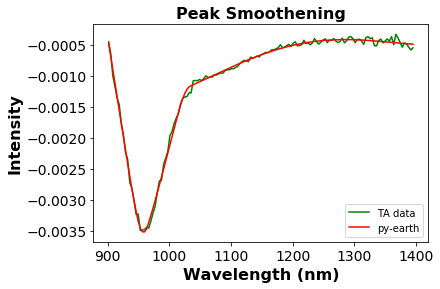

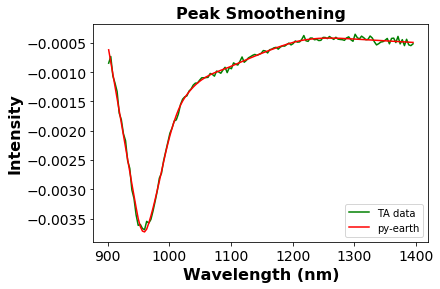

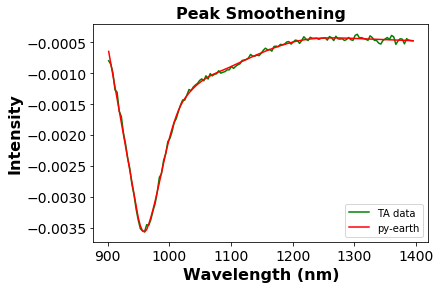

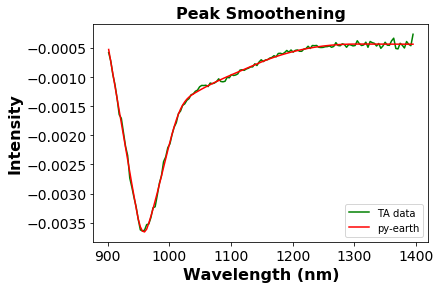

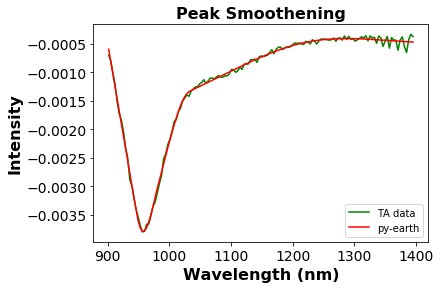

...

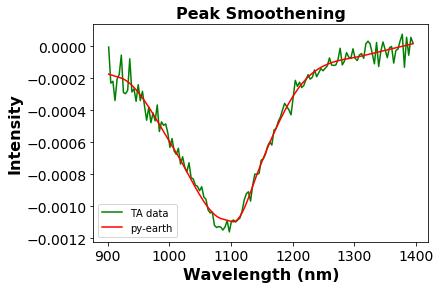

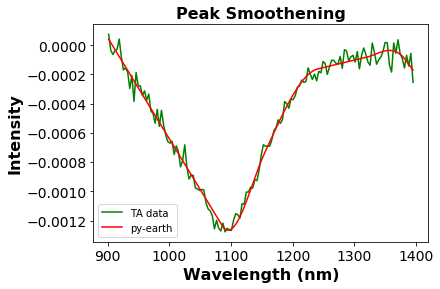

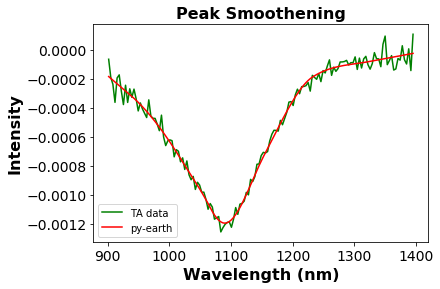

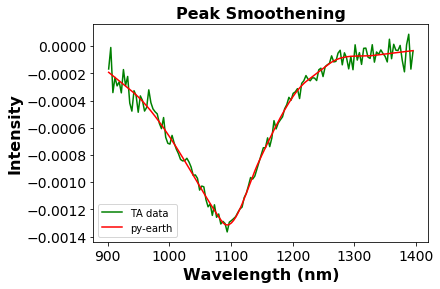

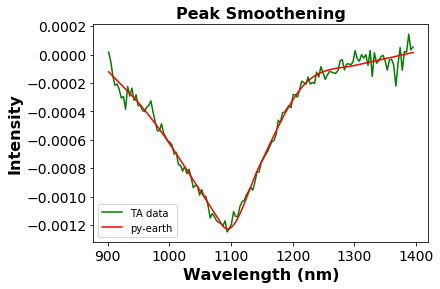

In [65]:
for i in range(tadata_z_corr.shape[1]):
    # plot the noise data curve and denoise curve
    plt.figure()
    plt.title('Peak Smoothening', fontsize = 16, fontweight = 'bold')
    plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
    plt.ylabel('Intensity', fontsize = 16, fontweight = 'bold')
    plt.xticks(fontsize = 14)
    plt.yticks(fontsize = 14)
    plt.plot(tadata_nm,tadata_z_corr[:,i],color='green',label = 'TA data')
    plt.plot(tadata_nm,smooth_matx1.iloc[:,i],color='red',label = 'py-earth')
    plt.legend()

In [ ]:
num_timeslice = np.shape(smooth_matx1)[1]
for i in range(num_timeslice):
    pplot(tadata_nm, smooth_matx1.iloc[:, i], smooth_df1.iloc[i, :].astype('int64'))

/Users/demiliu/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


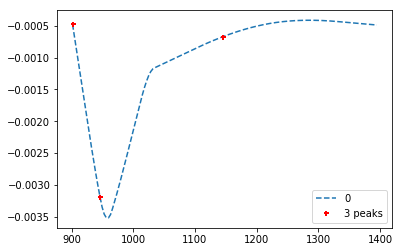

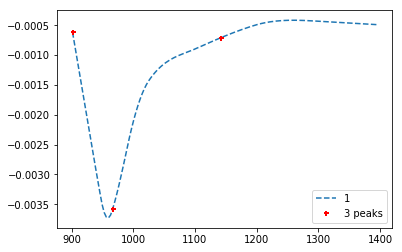

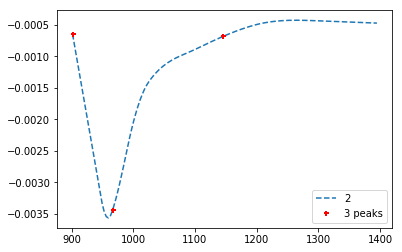

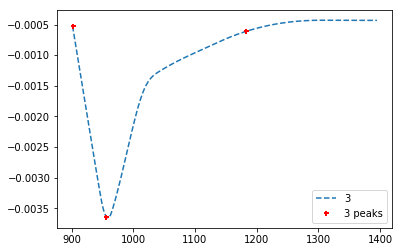

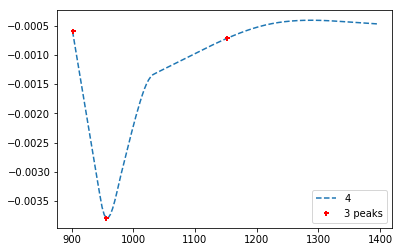

...

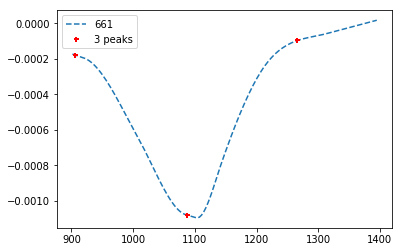

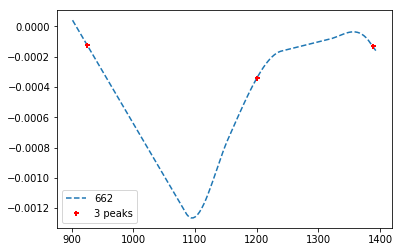

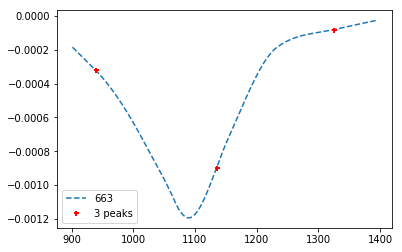

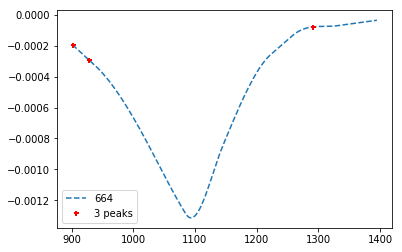

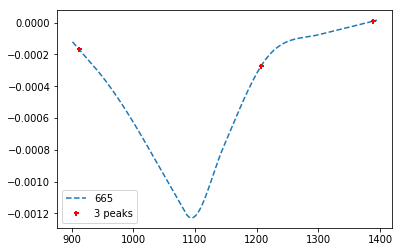

In [66]:
num_timeslice = np.shape(smooth_matx1)[1]
for i in range(num_timeslice):
    plt.figure()
    pplot(tadata_nm, smooth_matx1.iloc[:, i], smooth_df1.iloc[i, :].astype('int64'))

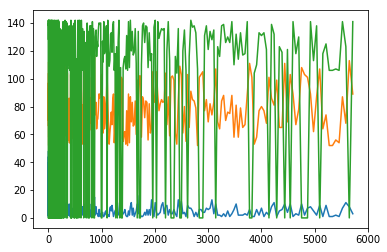

In [70]:
plt.figure()
for i in range(3):
    plt.plot(tadata_timedelay, smooth_df1.iloc[:, i])

In [72]:
tadata_nm[70]

1141.94

# 3D visualization

In [ ]:
def twodcontourplot(tadata_nm, tadata_timedelay, tadata_z_corr):
    """
    make contour plot
    
    Args:
        tadata_nm: wavelength array
        tadata_timedelay: time delay array
        tadata_z_corr: matrix of z values
        
    """
    nm, timedelay = np.linspace(tadata_nm.min(), tadata_nm.max(), 100), np.linspace(tadata_timedelay.min(), tadata_timedelay.max(), 100)    
    timedelayi, nmi = np.meshgrid(tadata_timedelay, tadata_nm)

    #find the maximum and minimum
    #these are used for color bar
    z_min = np.amin(np.amin(tadata_z_corr, axis = 1))
    z_max = np.amax(np.amax(tadata_z_corr, axis = 1))

    
    return [nmi, timedelayi, z_min, z_max]

* Contour plot of real TA-data 

In [ ]:
original_contour = twodcontourplot(tadata_nm, tadata_timedelay, tadata_z_corr)
nm_contour, time_contour, min_contour, max_contour = original_contour[0], original_contour[1], original_contour[2], original_contour[3]

plt.figure()
#plt.xlim(450,800)
plt.title('Real TA-data', fontsize = 16, fontweight = 'bold')
#plt.ylim(0,50)
plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
plt.ylabel('Time delay (ps)', fontsize = 16, fontweight = 'bold')
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.pcolormesh(nm_contour, time_contour, tadata_z_corr, cmap = 'PiYG', vmin=min_contour, vmax=max_contour)
plt.colorbar()
plt.tight_layout(pad=0.25, h_pad=None, w_pad=None, rect=None)

* Contour plot of py-earth denoised TA-data 

In [ ]:
smooth_contour = twodcontourplot(tadata_nm, tadata_timedelay, smooth_matx1)
nm_contour, time_contour, min_contour, max_contour = smooth_contour[0], smooth_contour[1], smooth_contour[2], smooth_contour[3]

plt.figure()
#plt.xlim(450,800)
plt.title('Pyearth de-noise TA-data', fontsize = 16, fontweight = 'bold')
#plt.ylim(0,50)
plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
plt.ylabel('Time delay (ps)', fontsize = 16, fontweight = 'bold')
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)

plt.pcolormesh(nm_contour, time_contour, smooth_matx1, cmap = 'PiYG', vmin=min_contour, vmax=max_contour)
plt.colorbar()
plt.tight_layout(pad=0.25, h_pad=None, w_pad=None, rect=None)

* Contour plot of astropy denoised TA-data 

In [ ]:
smooth_contour = twodcontourplot(tadata_nm, tadata_timedelay, smooth_matx2)
nm_contour, time_contour, min_contour, max_contour = smooth_contour[0], smooth_contour[1], smooth_contour[2], smooth_contour[3]

plt.figure()
#plt.xlim(450,800)
plt.title('Astropy de-noise TA-data', fontsize = 16, fontweight = 'bold')
#plt.ylim(0,50)
plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
plt.ylabel('Time delay (ps)', fontsize = 16, fontweight = 'bold')
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)

plt.pcolormesh(nm_contour, time_contour, smooth_matx2, cmap = 'PiYG', vmin=min_contour, vmax=max_contour)
plt.colorbar()
plt.tight_layout(pad=0.25, h_pad=None, w_pad=None, rect=None)

# peak width and fwhm

In [ ]:
def peakchar(data_nm, data_z_array, peak_index):
    """find the peak width, and intensity"""
    num_peaks = len(peak_index)
    
    #array of peak height
    height = [data_z_array[idx] for idx in peak_index]
    
    #array of peak width
    half_height = [ht / 2 for ht in height]

    fwhm_idx_1 = np.empty_like(half_height)
    fwhm_idx_2 = np.empty_like(fwhm_idx_1)
    fwhm_nm_1 = np.empty_like(fwhm_idx_1)
    fwhm_nm_2 = np.empty_like(fwhm_idx_1)
    
    for i in range(num_peaks):
        #find the index and nmof the left side of the fwhm
        if i == 0:
            fwhm_idx_1[i] = find_nearest(data_z_array[0:peak_index[i]], half_height[i])
        else:
            fwhm_idx_1[i] = find_nearest(data_z_array[peak_index[i-1]:peak_index[i]], half_height[i]) + peak_index[i-1]

        fwhm_nm_1[i] = data_nm[int(fwhm_idx_1[i])]
        
        #find the index and nm of the right side of the fwhm   
        fwhm_idx_2[i] = find_nearest(data_z_array[peak_index[i]:], half_height[i]) + peak_index[i]

        fwhm_nm_2[i] = data_nm[int(fwhm_idx_2[i])]
    
    #find fwhm
    fwhm = fwhm_nm_2 - fwhm_nm_1

    return height, fwhm

In [ ]:
def find_nearest(array,value):
    idx = (np.abs(array-value)).argmin()
    return idx

In [ ]:
def peak_matrix(nm_array,data_matrix, threshold, mindist):
    """find peaks in a data matrix"""
    peak_height_matx = []
    peak_fwhm_matx = []
    peak_idx_matx = []
    
    for i in range(data_matrix.shape[0]):
        data_timeslice = data_matrix.iloc[:,i]
        peak_idx = findpeak(data_timeslice, threshold, mindist).tolist()
        
        peak_idx_matx.append(peak_idx)
        peak_height, peak_fwhm = peakchar(nm_array, data_timeslice, peak_idx)
        
        peak_height_matx.append(peak_height)
        peak_fwhm_matx.append(peak_fwhm)
        
        # transfer to dataframe
        peak_height_df=pd.DataFrame(peak_height_matx)
        peak_fwhm_df=pd.DataFrame(peak_fwhm_matx)
        
    return peak_height_df, peak_fwhm_df

## goes little bug here...need to fix...

In [ ]:
peak_height_df, peak_fwhm_df = peak_matrix(tadata_nm,smooth_matx1, 0.00, 50)

In [ ]:
peak_height_df

In [ ]:
peak_fwhm_df